<a href="https://colab.research.google.com/github/delfinapirroncello/Coupons/blob/main/Projct_Data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd #análisis de datos
import numpy as np #facilidades matemáticas
import statistics #funciones estadísticas
import matplotlib.pyplot as plt #plot/gráficos
import plotly.express as px #varias figuras en un solo plot
import seaborn as sns #visuales


In [ ]:
a = [5, 10, 2]
b = [2, 4, 3]
dot = 0 #para encontrar el punto medio
for a,b in zip(a,b):
  dot = dot + a*b
  print('Mi producto punto es:', dot)

Mi producto punto es: 10
Mi producto punto es: 50
Mi producto punto es: 56


In [ ]:

a = [5, 10, 2]
b = [2, 4, 3] 
dot = np.dot(a,b) 
print('Mi producto punto es:', dot)

Mi producto punto es: 56


DATA FRAME


In [ ]:
a = ['chicle', 'queso', 'aguacate']
b = [20,30,40]

miprimerdataframe = pd.DataFrame(zip(a,b), columns = ['Producto', 'Precio'])

In [ ]:
miprimerdataframe

,Producto,Precio
0,chicle,20
1,queso,30
2,aguacate,40


In [ ]:
# https://drive.google.com/file/d/1wgLwewxyl2bQVh5Wxg4yix47eO4d6O1K/view?usp=sharing

url = "https://drive.google.com/uc?id="
data = '1wgLwewxyl2bQVh5Wxg4yix47eO4d6O1K'
df_psy = pd.read_csv(url+data) 


In [ ]:
df_psy

,Person,age,familysize,married,race,orientation,religion,country,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11
0,1,16,2.0,Never,White,Hetero,Other,US,1.0,7.0,7.0,7.0,7.0,5.0,1.0,4.0,2.0,4.0,4.0
1,2,16,5.0,Never,White,New Types,Christian Other,GB,6.0,4.0,7.0,4.0,7.0,7.0,1.0,4.0,2.0,4.0,4.0
2,3,17,1.0,Never,White,Homo,Christian,US,2.0,2.0,2.0,6.0,5.0,5.0,3.0,3.0,4.0,3.0,4.0
3,4,13,3.0,Never,Other,New Types,Christian,US,1.0,7.0,4.0,4.0,6.0,1.0,6.0,2.0,2.0,2.0,1.0
4,5,19,3.0,Never,White,Hetero,Muslim,ES,2.0,3.0,6.0,5.0,5.0,6.0,3.0,2.0,3.0,4.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39774,39772,21,4.0,Never,Asian,New Types,Muslim,MY,4.0,5.0,7.0,6.0,4.0,7.0,4.0,3.0,3.0,4.0,4.0
39775,39773,48,NaN,Married,NaN,Hetero,Christian Other,NaN,6.0,7.0,5.0,3.0,6.0,1.0,5.0,2.0,2.0,1.0,2.0
39776,39774,20,NaN,Never,NaN,Hetero,Protestant,NaN,1.0,5.0,7.0,5.0,3.0,5.0,3.0,3.0,2.0,4.0,4.0
39777,39775,26,NaN,Never,NaN,Hetero,Muslim,NaN,6.0,3.0,5.0,3.0,5.0,5.0,1.0,2.0,2.0,1.0,3.0


Plan de limpieza

1) Drop de Person

2) Duplicados

3) Null

4) Datos atípicos

5) Variable categóticas



In [ ]:
df_psy = df_psy.drop(df_psy.columns[0], axis = 1) #eliminar la columna 0 del eje horizontal
df_psy

,age,familysize,married,race,orientation,religion,country,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11
0,16,2.0,Never,White,Hetero,Other,US,1.0,7.0,7.0,7.0,7.0,5.0,1.0,4.0,2.0,4.0,4.0
1,16,5.0,Never,White,New Types,Christian Other,GB,6.0,4.0,7.0,4.0,7.0,7.0,1.0,4.0,2.0,4.0,4.0
2,17,1.0,Never,White,Homo,Christian,US,2.0,2.0,2.0,6.0,5.0,5.0,3.0,3.0,4.0,3.0,4.0
3,13,3.0,Never,Other,New Types,Christian,US,1.0,7.0,4.0,4.0,6.0,1.0,6.0,2.0,2.0,2.0,1.0
4,19,3.0,Never,White,Hetero,Muslim,ES,2.0,3.0,6.0,5.0,5.0,6.0,3.0,2.0,3.0,4.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39774,21,4.0,Never,Asian,New Types,Muslim,MY,4.0,5.0,7.0,6.0,4.0,7.0,4.0,3.0,3.0,4.0,4.0
39775,48,NaN,Married,NaN,Hetero,Christian Other,NaN,6.0,7.0,5.0,3.0,6.0,1.0,5.0,2.0,2.0,1.0,2.0
39776,20,NaN,Never,NaN,Hetero,Protestant,NaN,1.0,5.0,7.0,5.0,3.0,5.0,3.0,3.0,2.0,4.0,4.0
39777,26,NaN,Never,NaN,Hetero,Muslim,NaN,6.0,3.0,5.0,3.0,5.0,5.0,1.0,2.0,2.0,1.0,3.0


In [ ]:
# Duplicados
dupli = sum(df_psy.duplicated())
dupli  #una sola fila repetida

1

In [ ]:
# Sacar un porcentaje del duplicado
dupli = sum(df_psy.duplicated())
print(dupli/len(df_psy.index)*100)

0.002513889238040172


In [ ]:
df_psy = df_psy.drop_duplicates() #Lo va a eliminar

In [ ]:
#Comprobamos
dupli = sum(df_psy.duplicated())
dupli

0

In [ ]:
#Null
#Traemos toda la información del dataframe para que me muestre que tipo de dato es y los nulls 
display(df_psy.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 39778 entries, 0 to 39777
Data columns (total 18 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   age          39778 non-null  int64  
 1   familysize   39775 non-null  float64
 2   married      39778 non-null  object 
 3   race         39775 non-null  object 
 4   orientation  39777 non-null  object 
 5   religion     39776 non-null  object 
 6   country      39773 non-null  object 
 7   Q1           39776 non-null  float64
 8   Q2           39773 non-null  float64
 9   Q3           39774 non-null  float64
 10  Q4           39776 non-null  float64
 11  Q5           39774 non-null  float64
 12  Q6           39773 non-null  float64
 13  Q7           39774 non-null  float64
 14  Q8           39773 non-null  float64
 15  Q9           39774 non-null  float64
 16  Q10          39775 non-null  float64
 17  Q11          39776 non-null  float64
dtypes: float64(12), int64(1), object(5)
memory usa

None

In [ ]:
null = df_psy[df_psy.isna().any(axis=1)] #trae los valores nulos
null

,age,familysize,married,race,orientation,religion,country,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11
90,15,3.0,Never,White,New Types,NaN,US,1.0,NaN,NaN,6.0,NaN,6.0,NaN,NaN,NaN,4.0,4.0
137,20,7.0,Never,White,Hetero,Atheist,US,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
153,24,2.0,Never,Asian,Homo,Hindu,CA,5.0,NaN,4.0,5.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN
225,19,2.0,Never,Other,NaN,NaN,US,2.0,NaN,NaN,6.0,NaN,NaN,3.0,NaN,2.0,NaN,3.0
257,15,1.0,Never,Black,Homo,Jewish,CA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,2.0
6442,18,2.0,Never,White,Hetero,Muslim,NaN,4.0,4.0,1.0,4.0,5.0,5.0,6.0,1.0,1.0,1.0,1.0
35215,23,3.0,Never,White,New Types,Muslim,NaN,5.0,7.0,5.0,5.0,6.0,1.0,5.0,2.0,1.0,2.0,2.0
35721,27,1.0,Never,Native USA,Hetero,Muslim,US,1.0,3.0,5.0,7.0,5.0,NaN,2.0,2.0,2.0,3.0,3.0
39775,48,NaN,Married,NaN,Hetero,Christian Other,NaN,6.0,7.0,5.0,3.0,6.0,1.0,5.0,2.0,2.0,1.0,2.0
39776,20,NaN,Never,NaN,Hetero,Protestant,NaN,1.0,5.0,7.0,5.0,3.0,5.0,3.0,3.0,2.0,4.0,4.0


In [ ]:
df_psy['Q6'][35721] = 30

<ipython-input-15-023534237fa3>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_psy['Q6'][35721] = 30


In [ ]:
null = df_psy[df_psy.isna().any(axis=1)] #traigo los nulos para corroborar que la fila 35721 no este 
null

,age,familysize,married,race,orientation,religion,country,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11
90,15,3.0,Never,White,New Types,NaN,US,1.0,NaN,NaN,6.0,NaN,6.0,NaN,NaN,NaN,4.0,4.0
137,20,7.0,Never,White,Hetero,Atheist,US,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
153,24,2.0,Never,Asian,Homo,Hindu,CA,5.0,NaN,4.0,5.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN
225,19,2.0,Never,Other,NaN,NaN,US,2.0,NaN,NaN,6.0,NaN,NaN,3.0,NaN,2.0,NaN,3.0
257,15,1.0,Never,Black,Homo,Jewish,CA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,2.0
6442,18,2.0,Never,White,Hetero,Muslim,NaN,4.0,4.0,1.0,4.0,5.0,5.0,6.0,1.0,1.0,1.0,1.0
35215,23,3.0,Never,White,New Types,Muslim,NaN,5.0,7.0,5.0,5.0,6.0,1.0,5.0,2.0,1.0,2.0,2.0
39775,48,NaN,Married,NaN,Hetero,Christian Other,NaN,6.0,7.0,5.0,3.0,6.0,1.0,5.0,2.0,2.0,1.0,2.0
39776,20,NaN,Never,NaN,Hetero,Protestant,NaN,1.0,5.0,7.0,5.0,3.0,5.0,3.0,3.0,2.0,4.0,4.0
39777,26,NaN,Never,NaN,Hetero,Muslim,NaN,6.0,3.0,5.0,3.0,5.0,5.0,1.0,2.0,2.0,1.0,3.0


In [ ]:
#Elimino el resto de los nulos del dataframe
df_psy = df_psy.dropna()

In [ ]:
null = df_psy[df_psy.isna().any(axis=1)] #corroborar
null  

,age,familysize,married,race,orientation,religion,country,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11


In [ ]:
#Para predecir el valor que me falta de la fila 35721
df_psy['Q6'][35721] = np.nan #para que coloque el valor Nan hay que pedirle a np que nos coloque el valor

In [ ]:
null = df_psy[df_psy.isna().any(axis=1)] # nulo
null

,age,familysize,married,race,orientation,religion,country,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11
35721,27,1.0,Never,Native USA,Hetero,Muslim,US,1.0,3.0,5.0,7.0,5.0,NaN,2.0,2.0,2.0,3.0,3.0


In [ ]:
#Comenzamos a predecir
imputar = df_psy[['Q1', 'Q2', 'Q3', 'Q4', 'Q5', 'Q6', 'Q7', 'Q8', 'Q9', 'Q10', 'Q11']]
imputar

,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11
0,1.0,7.0,7.0,7.0,7.0,5.0,1.0,4.0,2.0,4.0,4.0
1,6.0,4.0,7.0,4.0,7.0,7.0,1.0,4.0,2.0,4.0,4.0
2,2.0,2.0,2.0,6.0,5.0,5.0,3.0,3.0,4.0,3.0,4.0
3,1.0,7.0,4.0,4.0,6.0,1.0,6.0,2.0,2.0,2.0,1.0
4,2.0,3.0,6.0,5.0,5.0,6.0,3.0,2.0,3.0,4.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...
39770,1.0,5.0,7.0,6.0,6.0,4.0,3.0,4.0,4.0,3.0,4.0
39771,6.0,6.0,7.0,4.0,6.0,5.0,5.0,2.0,1.0,2.0,2.0
39772,6.0,4.0,5.0,3.0,5.0,2.0,5.0,3.0,2.0,2.0,4.0
39773,2.0,3.0,5.0,5.0,5.0,3.0,3.0,2.0,3.0,3.0,4.0


In [ ]:
from sklearn.impute import SimpleImputer
imp = SimpleImputer(missing_values= np.nan, strategy = 'mean')  #va a utilizar la media de esos valores
imp.fit(imputar)

SimpleImputer()

SimpleImputer()

In [ ]:
imputar = pd.DataFrame(imp.transform(imputar), columns = ['Q1', 'Q2', 'Q3', 'Q4', 'Q5', 'Q6', 'Q7', 'Q8', 'Q9', 'Q10', 'Q11']) #con eso que obtuvo va a construirlo el DataFrame
imputar # dataframe con el valor ya predecido

,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11
0,1.0,7.0,7.0,7.0,7.0,5.0,1.0,4.0,2.0,4.0,4.0
1,6.0,4.0,7.0,4.0,7.0,7.0,1.0,4.0,2.0,4.0,4.0
2,2.0,2.0,2.0,6.0,5.0,5.0,3.0,3.0,4.0,3.0,4.0
3,1.0,7.0,4.0,4.0,6.0,1.0,6.0,2.0,2.0,2.0,1.0
4,2.0,3.0,6.0,5.0,5.0,6.0,3.0,2.0,3.0,4.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...
39763,1.0,5.0,7.0,6.0,6.0,4.0,3.0,4.0,4.0,3.0,4.0
39764,6.0,6.0,7.0,4.0,6.0,5.0,5.0,2.0,1.0,2.0,2.0
39765,6.0,4.0,5.0,3.0,5.0,2.0,5.0,3.0,2.0,2.0,4.0
39766,2.0,3.0,5.0,5.0,5.0,3.0,3.0,2.0,3.0,3.0,4.0


In [ ]:
null = imputar[imputar.isna().any(axis=1)] #verificar el nulo
null #corroboro que no haya datos nulos

,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11


In [ ]:
imputar['Q6'][35721] #verificar que valor puso

3.0

In [ ]:
df_psy['Q6'][[35721]] = imputar['Q6'][35721] #le agrego el 3.0

<ipython-input-26-c5af51bac13b>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_psy['Q6'][[35721]] = imputar['Q6'][35721] #le agrego el 3.0


In [ ]:
display(df_psy.info())  #reviso que pasa con nuestros valores --> tenemos el mismo valor en todas las columnas, significa que no tenemos mas nulos

<class 'pandas.core.frame.DataFrame'>
Int64Index: 39768 entries, 0 to 39774
Data columns (total 18 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   age          39768 non-null  int64  
 1   familysize   39768 non-null  float64
 2   married      39768 non-null  object 
 3   race         39768 non-null  object 
 4   orientation  39768 non-null  object 
 5   religion     39768 non-null  object 
 6   country      39768 non-null  object 
 7   Q1           39768 non-null  float64
 8   Q2           39768 non-null  float64
 9   Q3           39768 non-null  float64
 10  Q4           39768 non-null  float64
 11  Q5           39768 non-null  float64
 12  Q6           39768 non-null  float64
 13  Q7           39768 non-null  float64
 14  Q8           39768 non-null  float64
 15  Q9           39768 non-null  float64
 16  Q10          39768 non-null  float64
 17  Q11          39768 non-null  float64
dtypes: float64(12), int64(1), object(5)
memory usa

None

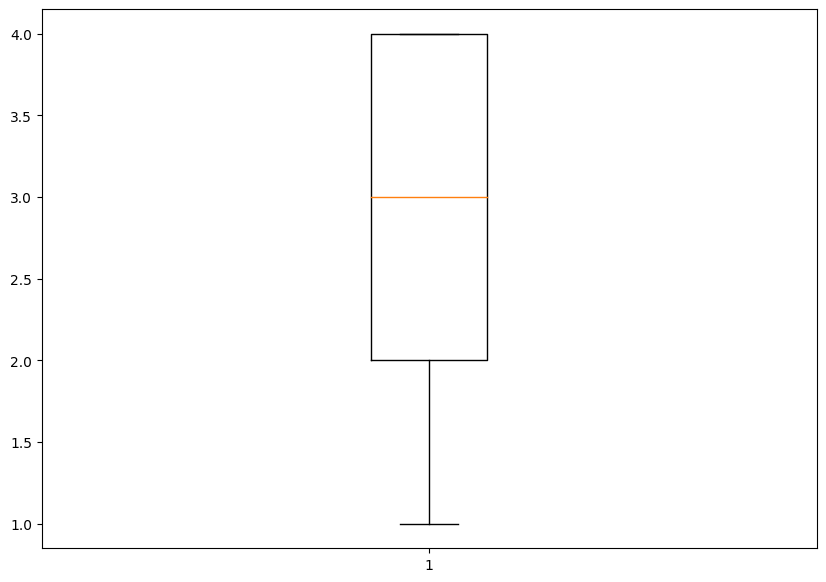

In [ ]:
#Datos Atípicos 
var = df_psy['Q8']
fig = plt.figure(figsize = (10,7))  #forma correcta de graficar
plt.boxplot(var)  #le vamos a pedir que nos grafique nuestra variable
plt.show() #mostrar
px.box(var, points= 'all') #mas ordenado donde va a poder tener los valores

In [ ]:
#MÉTODO RÁPIDO PARA ANALIZAR 
num = df_psy.drop(['married', 'orientation', 'religion', 'race', 'country'], axis = 1)
fig = px.box(num.melt(), y = "value", facet_col = 'variable', boxmode = 'overlay', color = 'variable')
fig.update_yaxes(matches= None)  #veo los datos atípicos como por ejemplo alguien de 223 años etc

In [ ]:
maxage = num['age'].max() #cual es la edad máxima
maxage

1998

In [ ]:
Maxage = num[num['age']>100] #todas las personas +100
Maxage

,age,familysize,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11
5342,223,4.0,7.0,6.0,3.0,2.0,1.0,2.0,6.0,2.0,1.0,1.0,1.0
10233,1996,1.0,5.0,7.0,7.0,7.0,5.0,3.0,5.0,4.0,4.0,3.0,4.0
14238,117,6.0,3.0,1.0,7.0,6.0,3.0,6.0,2.0,4.0,3.0,4.0,3.0
21385,1998,6.0,1.0,1.0,6.0,7.0,1.0,1.0,1.0,2.0,1.0,2.0,2.0
24900,115,5.0,5.0,3.0,6.0,6.0,5.0,6.0,2.0,3.0,2.0,1.0,2.0
30029,1993,2.0,4.0,7.0,7.0,7.0,7.0,6.0,2.0,4.0,4.0,3.0,4.0
33732,1991,4.0,2.0,7.0,7.0,5.0,6.0,6.0,2.0,3.0,3.0,3.0,4.0


In [ ]:
df_psy = df_psy[df_psy['age']<100] # elimino a todos los mayores de 100 años
df_psy 

,age,familysize,married,race,orientation,religion,country,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11
0,16,2.0,Never,White,Hetero,Other,US,1.0,7.0,7.0,7.0,7.0,5.0,1.0,4.0,2.0,4.0,4.0
1,16,5.0,Never,White,New Types,Christian Other,GB,6.0,4.0,7.0,4.0,7.0,7.0,1.0,4.0,2.0,4.0,4.0
2,17,1.0,Never,White,Homo,Christian,US,2.0,2.0,2.0,6.0,5.0,5.0,3.0,3.0,4.0,3.0,4.0
3,13,3.0,Never,Other,New Types,Christian,US,1.0,7.0,4.0,4.0,6.0,1.0,6.0,2.0,2.0,2.0,1.0
4,19,3.0,Never,White,Hetero,Muslim,ES,2.0,3.0,6.0,5.0,5.0,6.0,3.0,2.0,3.0,4.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39770,19,1.0,Never,White,Hetero,Muslim,US,1.0,5.0,7.0,6.0,6.0,4.0,3.0,4.0,4.0,3.0,4.0
39771,27,4.0,Never,Asian,Hetero,Christian,PK,6.0,6.0,7.0,4.0,6.0,5.0,5.0,2.0,1.0,2.0,2.0
39772,16,2.0,Never,Arab,Hetero,Agnostic,EG,6.0,4.0,5.0,3.0,5.0,2.0,5.0,3.0,2.0,2.0,4.0
39773,16,4.0,Never,Asian,Asexual,Atheist,MY,2.0,3.0,5.0,5.0,5.0,3.0,3.0,2.0,3.0,3.0,4.0


In [ ]:
df_psy = df_psy[df_psy['Q4']< 8] # elimino a todos menores a 8/5 que son datos atípicos
df_psy = df_psy[df_psy['Q5']< 8]
df_psy = df_psy[df_psy['Q11']< 5]
df_psy 

,age,familysize,married,race,orientation,religion,country,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11
0,16,2.0,Never,White,Hetero,Other,US,1.0,7.0,7.0,7.0,7.0,5.0,1.0,4.0,2.0,4.0,4.0
1,16,5.0,Never,White,New Types,Christian Other,GB,6.0,4.0,7.0,4.0,7.0,7.0,1.0,4.0,2.0,4.0,4.0
2,17,1.0,Never,White,Homo,Christian,US,2.0,2.0,2.0,6.0,5.0,5.0,3.0,3.0,4.0,3.0,4.0
3,13,3.0,Never,Other,New Types,Christian,US,1.0,7.0,4.0,4.0,6.0,1.0,6.0,2.0,2.0,2.0,1.0
4,19,3.0,Never,White,Hetero,Muslim,ES,2.0,3.0,6.0,5.0,5.0,6.0,3.0,2.0,3.0,4.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39770,19,1.0,Never,White,Hetero,Muslim,US,1.0,5.0,7.0,6.0,6.0,4.0,3.0,4.0,4.0,3.0,4.0
39771,27,4.0,Never,Asian,Hetero,Christian,PK,6.0,6.0,7.0,4.0,6.0,5.0,5.0,2.0,1.0,2.0,2.0
39772,16,2.0,Never,Arab,Hetero,Agnostic,EG,6.0,4.0,5.0,3.0,5.0,2.0,5.0,3.0,2.0,2.0,4.0
39773,16,4.0,Never,Asian,Asexual,Atheist,MY,2.0,3.0,5.0,5.0,5.0,3.0,3.0,2.0,3.0,3.0,4.0


In [ ]:
#analizo el resultado luego de eliminar los datos atípicos 
num = df_psy.drop(['married', 'orientation', 'religion', 'race', 'country'], axis = 1)
fig = px.box(num.melt(), y = "value", facet_col = 'variable', boxmode = 'overlay', color = 'variable')
fig.update_yaxes(matches= None)  

In [ ]:
#Muestre los valores unicos 
df_psy.married.unique()

array(['Never', 'Previously', 'Married', 'Second', 'FALSE'], dtype=object)

In [ ]:
df_psy.orientation.unique()

array(['Hetero', 'New Types', 'Homo', 'Bi', 'Asexual', 'FALSE'],
      dtype=object)

In [ ]:
df_psy.religion.unique()

array(['Other', 'Christian Other', 'Christian', 'Muslim', 'Atheist',
       'Protestant', 'Agnostic', 'Hindu', 'Buddhist', 'Mormon', 'Sikh',
       'Jewish', 'FALSE'], dtype=object)

In [ ]:
df_psy.race.unique()

array(['White', 'Other', 'Asian', 'Black', 'Arab', 'Native USA',
       'Indigenous'], dtype=object)

In [ ]:
false = df_psy[df_psy['married']== 'FALSE']
false

,age,familysize,married,race,orientation,religion,country,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11
39401,43,3.0,FALSE,Other,FALSE,FALSE,ID,2.0,7.0,5.0,5.0,7.0,1.0,3.0,1.0,1.0,2.0,1.0


In [ ]:
#eliminamos el false 
df_psy = df_psy[df_psy['religion'] != 'FALSE']

In [ ]:
#VERIFICAMOS 
df_psy

,age,familysize,married,race,orientation,religion,country,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11
0,16,2.0,Never,White,Hetero,Other,US,1.0,7.0,7.0,7.0,7.0,5.0,1.0,4.0,2.0,4.0,4.0
1,16,5.0,Never,White,New Types,Christian Other,GB,6.0,4.0,7.0,4.0,7.0,7.0,1.0,4.0,2.0,4.0,4.0
2,17,1.0,Never,White,Homo,Christian,US,2.0,2.0,2.0,6.0,5.0,5.0,3.0,3.0,4.0,3.0,4.0
3,13,3.0,Never,Other,New Types,Christian,US,1.0,7.0,4.0,4.0,6.0,1.0,6.0,2.0,2.0,2.0,1.0
4,19,3.0,Never,White,Hetero,Muslim,ES,2.0,3.0,6.0,5.0,5.0,6.0,3.0,2.0,3.0,4.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39770,19,1.0,Never,White,Hetero,Muslim,US,1.0,5.0,7.0,6.0,6.0,4.0,3.0,4.0,4.0,3.0,4.0
39771,27,4.0,Never,Asian,Hetero,Christian,PK,6.0,6.0,7.0,4.0,6.0,5.0,5.0,2.0,1.0,2.0,2.0
39772,16,2.0,Never,Arab,Hetero,Agnostic,EG,6.0,4.0,5.0,3.0,5.0,2.0,5.0,3.0,2.0,2.0,4.0
39773,16,4.0,Never,Asian,Asexual,Atheist,MY,2.0,3.0,5.0,5.0,5.0,3.0,3.0,2.0,3.0,3.0,4.0


In [ ]:
#Realizamos un diccionario 
matrimonio = {
    'Never' : 1,
    'Previously' : 2,
    'Married' : 3,
    'Second' : 4
              }

df_psy['Matrimonio'] = df_psy['married'].map(matrimonio)

sexualidad = {
    'Hetero' : 1,
    'New Types' : 2,
    'Homo' : 3,
    'Bi' : 4,
    'Asexual' : 5
              }

df_psy['Orientacion'] = df_psy['orientation'].map(sexualidad)

creencia = {
    'Other' : 1,
    'Christian Other' : 2,
    'Christian' : 3,
    'Muslim' : 4,
    'Atheist' : 5,
    'Protestant' : 6,
    'Agnostic' : 7,
    'Hindu' : 8,
    'Buddhist' : 9,
    'Mormon' : 10,
    'Sikh' : 11,
    'Jewish' : 12
              }

df_psy['Religion'] = df_psy['religion'].map(creencia)


Raz = {
    'White' : 1,
    'Other' : 2,
    'Asian' : 3,
    'Black' : 4,
    'Arab' : 5,
    'Native USA' : 6,
    'Indigenous' : 7
              }

df_psy['Raza'] = df_psy['race'].map(Raz)


<ipython-input-42-fc9199c4d615>:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-42-fc9199c4d615>:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-42-fc9199c4d615>:36: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-42-fc919

In [ ]:
df_psy

,age,familysize,married,race,orientation,religion,country,Q1,Q2,Q3,...,Q6,Q7,Q8,Q9,Q10,Q11,Matrimonio,Orientacion,Religion,Raza
0,16,2.0,Never,White,Hetero,Other,US,1.0,7.0,7.0,...,5.0,1.0,4.0,2.0,4.0,4.0,1,1,1,1
1,16,5.0,Never,White,New Types,Christian Other,GB,6.0,4.0,7.0,...,7.0,1.0,4.0,2.0,4.0,4.0,1,2,2,1
2,17,1.0,Never,White,Homo,Christian,US,2.0,2.0,2.0,...,5.0,3.0,3.0,4.0,3.0,4.0,1,3,3,1
3,13,3.0,Never,Other,New Types,Christian,US,1.0,7.0,4.0,...,1.0,6.0,2.0,2.0,2.0,1.0,1,2,3,2
4,19,3.0,Never,White,Hetero,Muslim,ES,2.0,3.0,6.0,...,6.0,3.0,2.0,3.0,4.0,4.0,1,1,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39770,19,1.0,Never,White,Hetero,Muslim,US,1.0,5.0,7.0,...,4.0,3.0,4.0,4.0,3.0,4.0,1,1,4,1
39771,27,4.0,Never,Asian,Hetero,Christian,PK,6.0,6.0,7.0,...,5.0,5.0,2.0,1.0,2.0,2.0,1,1,3,3
39772,16,2.0,Never,Arab,Hetero,Agnostic,EG,6.0,4.0,5.0,...,2.0,5.0,3.0,2.0,2.0,4.0,1,1,7,5
39773,16,4.0,Never,Asian,Asexual,Atheist,MY,2.0,3.0,5.0,...,3.0,3.0,2.0,3.0,3.0,4.0,1,5,5,3


In [ ]:
all = df_psy
allnumeric = df_psy.drop(['married', 'orientation', 'religion', 'race', 'country'], axis = 1)  #hacer los valores numericos
all

,age,familysize,married,race,orientation,religion,country,Q1,Q2,Q3,...,Q6,Q7,Q8,Q9,Q10,Q11,Matrimonio,Orientacion,Religion,Raza
0,16,2.0,Never,White,Hetero,Other,US,1.0,7.0,7.0,...,5.0,1.0,4.0,2.0,4.0,4.0,1,1,1,1
1,16,5.0,Never,White,New Types,Christian Other,GB,6.0,4.0,7.0,...,7.0,1.0,4.0,2.0,4.0,4.0,1,2,2,1
2,17,1.0,Never,White,Homo,Christian,US,2.0,2.0,2.0,...,5.0,3.0,3.0,4.0,3.0,4.0,1,3,3,1
3,13,3.0,Never,Other,New Types,Christian,US,1.0,7.0,4.0,...,1.0,6.0,2.0,2.0,2.0,1.0,1,2,3,2
4,19,3.0,Never,White,Hetero,Muslim,ES,2.0,3.0,6.0,...,6.0,3.0,2.0,3.0,4.0,4.0,1,1,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39770,19,1.0,Never,White,Hetero,Muslim,US,1.0,5.0,7.0,...,4.0,3.0,4.0,4.0,3.0,4.0,1,1,4,1
39771,27,4.0,Never,Asian,Hetero,Christian,PK,6.0,6.0,7.0,...,5.0,5.0,2.0,1.0,2.0,2.0,1,1,3,3
39772,16,2.0,Never,Arab,Hetero,Agnostic,EG,6.0,4.0,5.0,...,2.0,5.0,3.0,2.0,2.0,4.0,1,1,7,5
39773,16,4.0,Never,Asian,Asexual,Atheist,MY,2.0,3.0,5.0,...,3.0,3.0,2.0,3.0,3.0,4.0,1,5,5,3


In [ ]:
allnumeric

,age,familysize,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11,Matrimonio,Orientacion,Religion,Raza
0,16,2.0,1.0,7.0,7.0,7.0,7.0,5.0,1.0,4.0,2.0,4.0,4.0,1,1,1,1
1,16,5.0,6.0,4.0,7.0,4.0,7.0,7.0,1.0,4.0,2.0,4.0,4.0,1,2,2,1
2,17,1.0,2.0,2.0,2.0,6.0,5.0,5.0,3.0,3.0,4.0,3.0,4.0,1,3,3,1
3,13,3.0,1.0,7.0,4.0,4.0,6.0,1.0,6.0,2.0,2.0,2.0,1.0,1,2,3,2
4,19,3.0,2.0,3.0,6.0,5.0,5.0,6.0,3.0,2.0,3.0,4.0,4.0,1,1,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39770,19,1.0,1.0,5.0,7.0,6.0,6.0,4.0,3.0,4.0,4.0,3.0,4.0,1,1,4,1
39771,27,4.0,6.0,6.0,7.0,4.0,6.0,5.0,5.0,2.0,1.0,2.0,2.0,1,1,3,3
39772,16,2.0,6.0,4.0,5.0,3.0,5.0,2.0,5.0,3.0,2.0,2.0,4.0,1,1,7,5
39773,16,4.0,2.0,3.0,5.0,5.0,5.0,3.0,3.0,2.0,3.0,3.0,4.0,1,5,5,3


EDA |

In [ ]:
#VALOR QUE MAS SE REPITE
M = all ['married'].mode()
O = all ['orientation'].mode()
R = all ['religion'].mode()
Z = all ['race'].mode()
Z

0    Asian
Name: race, dtype: object

In [ ]:
campos = [M, O, R, Z]
moda = pd.DataFrame({
    'Casamiento' : campos[0],
    'Orientacion' : campos[1],
    'Religion' : campos[2],
    'Raza' : campos[3]
})  #todos los valores que mas se repitan
moda

,Casamiento,Orientacion,Religion,Raza
0,Never,Hetero,Muslim,Asian


In [ ]:
all.loc[:, 'age'].mean() #calcular la media de todas las edades

23.39572905400307

In [ ]:
allnumeric.describe() #resumen estadístico

,age,familysize,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11,Matrimonio,Orientacion,Religion,Raza
count,39757.000000,39757.000000,39757.000000,39757.000000,39757.000000,39757.000000,39757.000000,39757.000000,39757.000000,39757.000000,39757.000000,39757.000000,39757.000000,39757.000000,39757.000000,39757.000000,39757.000000
mean,23.395729,3.499736,3.798425,4.757125,5.184596,4.863772,5.268431,4.297658,3.660311,2.619564,2.226199,2.480519,2.784642,1.261162,1.839827,4.278291,2.393314
std,8.548658,1.917671,1.881424,1.767918,1.795094,1.875892,1.606651,1.936820,1.811937,1.032095,1.038581,1.052359,1.073748,0.664362,1.258756,1.632446,0.965716
min,13.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,18.000000,2.000000,2.000000,4.000000,4.000000,4.000000,5.000000,3.000000,2.000000,2.000000,1.000000,2.000000,2.000000,1.000000,1.000000,4.000000,1.000000
50%,21.000000,3.000000,4.000000,5.000000,6.000000,5.000000,6.000000,5.000000,4.000000,3.000000,2.000000,2.000000,3.000000,1.000000,1.000000,4.000000,3.000000
75%,25.000000,4.000000,5.000000,6.000000,7.000000,6.000000,7.000000,6.000000,5.000000,4.000000,3.000000,3.000000,4.000000,1.000000,2.000000,5.000000,3.000000
max,79.000000,24.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,12.000000,7.000000


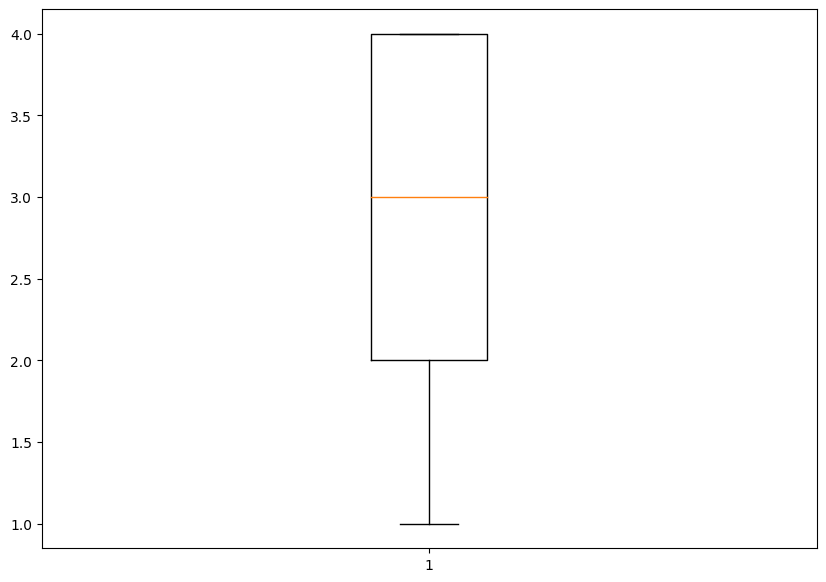

2.6195638503911263
1.0320951630178519


In [ ]:
#visualizarlo de manera gráfica
fig = plt.figure(figsize = (10, 7))
plt.boxplot(all['Q8'])
plt.show()
print(all['Q8'].mean())
print(all['Q8'].std())

<Axes: xlabel='age'>

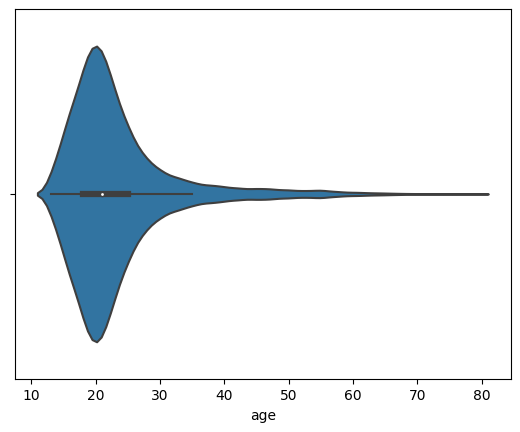

In [ ]:
#GRAFICO UNIVARIADO
#gráfico violín cantidad de personas  // veo la data de forma continua 
sns.violinplot(data = allnumeric, x = allnumeric.age) 

<Axes: xlabel='age'>

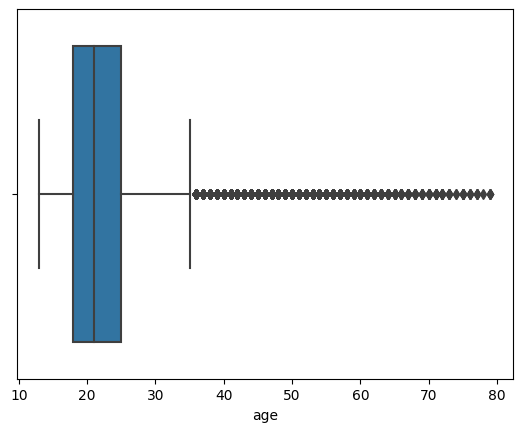

In [ ]:
sns.boxplot(x = all.age) #veo la data de forma discreta 

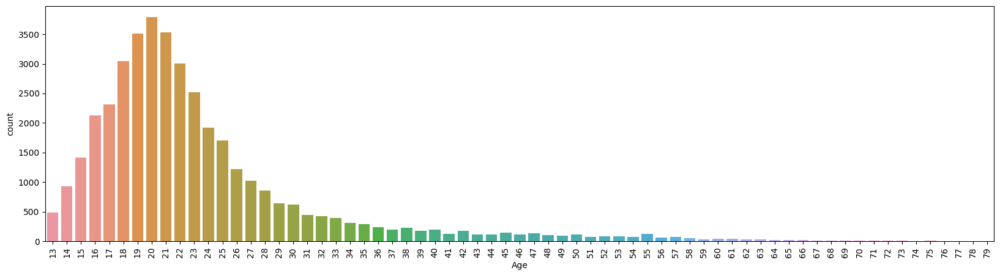

In [ ]:
#de barras
plt.figure(figsize = (20,5))
sns.countplot(x = allnumeric ['age'])
plt.xlabel('Age')
plt.xticks(rotation =90)
plt.show()

<Axes: xlabel='age', ylabel='Count'>

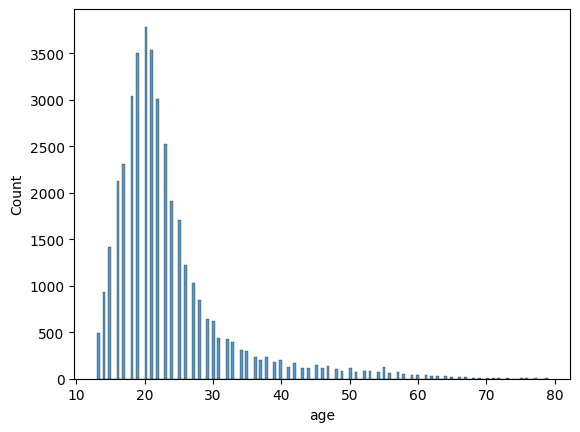

In [ ]:
sns.histplot( x = allnumeric['age'] )

In [ ]:
agess = allnumeric[allnumeric['age']>55] 
mayores = len(agess.index)
totalidad = len(allnumeric.index)
print(mayores/totalidad*100)  #calcular el porcentaje de mayores a 55 años (da 1,2%)

1.2802776869482104


In [ ]:
agess = allnumeric[allnumeric['age']<35] 
mayores = len(agess.index)
totalidad = len(allnumeric.index)
print(mayores/totalidad*100)  #calcular el porcentaje de menores a 35 (da 91%)

91.1487285257942


Insight = de toda mi población dentro del análisis un 98% de las personas son menores a 55. El 91% de encuestados son menores a 35 años.

<Axes: xlabel='Q3'>

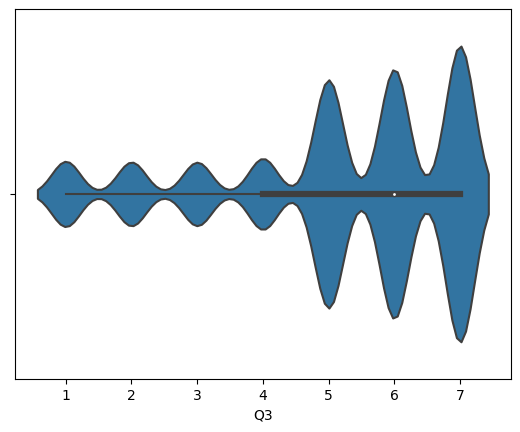

In [ ]:
sns.violinplot(data = allnumeric, x = allnumeric.Q3) #la pregunta 3: si la persona se siente ansiosa

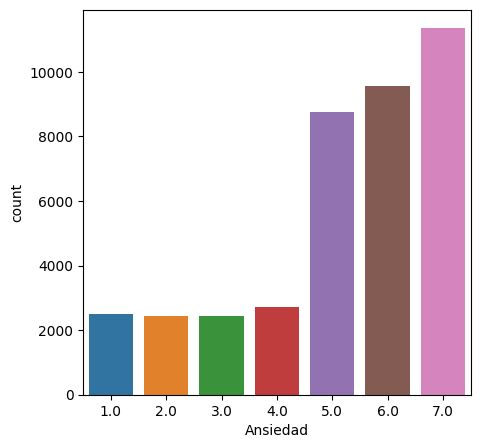

In [ ]:
plt.figure(figsize = (5,5))
sns.countplot(x = allnumeric ['Q3'])
plt.xlabel('Ansiedad')
plt.show()

In [ ]:
n = allnumeric['Q3'].value_counts() #contar los valores por cada una de las respuestas
count = pd.DataFrame(n)
count
altos = count.loc[7] + count.loc[6] + count.loc[5] #loc le pide que tome el indice 7
total = count['Q3'].sum()
altosprop = altos/total

solosiete = count.loc[7]/total

print("por encima de 5", altosprop*100) #*100 para que me lo calcule con porcentaje
print("valores en 7", solosiete*100)
print("Valores solo en 1", (count.loc[1]/total)*100)

por encima de 5 Q3    74.600699
dtype: float64
valores en 7 Q3    28.555978
Name: 7.0, dtype: float64
Valores solo en 1 Q3    6.295747
Name: 1.0, dtype: float64


Cuando se trata de ansiedad e irritación, el 74% de las personas responde con valores altos. Un 28% es el valor mas alto de ansiedad. El 6% de las personas se considera poro ansiosa.



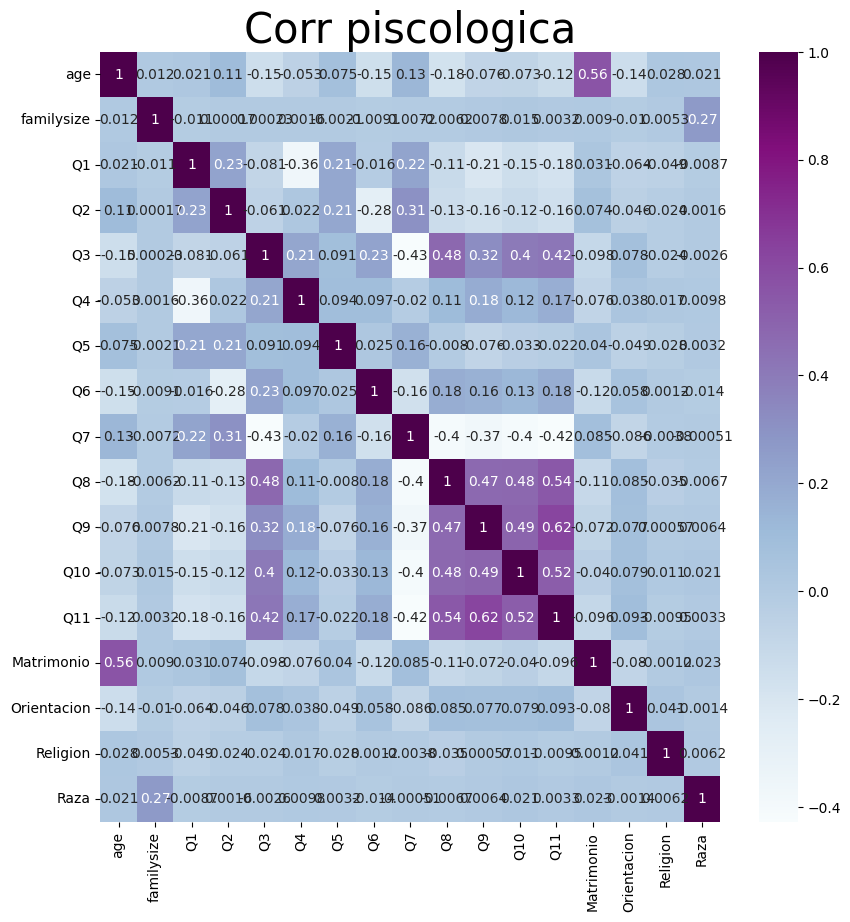

In [ ]:
#ANALISIS BIVARIADO


#gráfico de correlaciones
plt.rcParams['figure.figsize'] = (10,10)
sns.heatmap(allnumeric.corr(), annot=True, cmap= 'BuPu')  #ver en las documentaciones los tipos que exísten
plt.title('Corr piscologica', fontsize = 30)
plt.show()

Las personas que sienten emociones negativas o mayor exaltación tienen una correlación positiva con los sentimientos de tristeza o menos posibilidad de sentirse relajados/as. Cuanto mas tranquila se identifica una persona, menos indicadores de emociones tristes experimenta. 

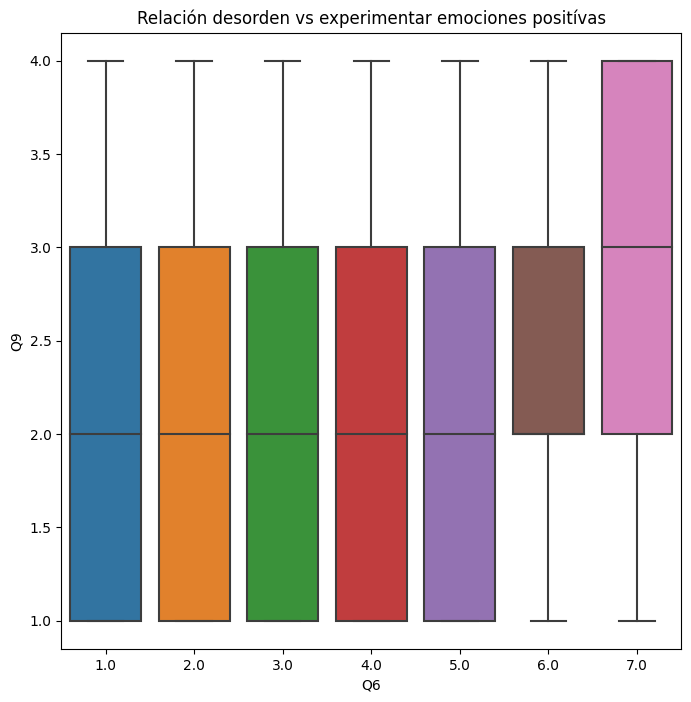

In [ ]:
#comparacion de persona desorganizada en relación con sentir emociones positívas o negatívas
plt.rcParams['figure.figsize'] = (8,8)
sns.boxplot(x='Q6', y='Q9', data=allnumeric)
plt.title('Relación desorden vs experimentar emociones positívas')
plt.show()

In [ ]:
#Agrupar rango de edades 
allnumeric.loc[allnumeric['age'] >= 0, 'agegroup'] = '20'
allnumeric.loc[allnumeric['age'] >= 20, 'agegroup'] = '40'
allnumeric.loc[allnumeric['age'] >= 40, 'agegroup'] = '60'
allnumeric.loc[allnumeric['age'] >= 60, 'agegroup'] = '80'
allnumeric.loc[allnumeric['age'] >= 80, 'agegroup'] = '100'

In [ ]:
allnumeric

,age,familysize,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11,Matrimonio,Orientacion,Religion,Raza,agegroup
0,16,2.0,1.0,7.0,7.0,7.0,7.0,5.0,1.0,4.0,2.0,4.0,4.0,1,1,1,1,20
1,16,5.0,6.0,4.0,7.0,4.0,7.0,7.0,1.0,4.0,2.0,4.0,4.0,1,2,2,1,20
2,17,1.0,2.0,2.0,2.0,6.0,5.0,5.0,3.0,3.0,4.0,3.0,4.0,1,3,3,1,20
3,13,3.0,1.0,7.0,4.0,4.0,6.0,1.0,6.0,2.0,2.0,2.0,1.0,1,2,3,2,20
4,19,3.0,2.0,3.0,6.0,5.0,5.0,6.0,3.0,2.0,3.0,4.0,4.0,1,1,4,1,20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39770,19,1.0,1.0,5.0,7.0,6.0,6.0,4.0,3.0,4.0,4.0,3.0,4.0,1,1,4,1,20
39771,27,4.0,6.0,6.0,7.0,4.0,6.0,5.0,5.0,2.0,1.0,2.0,2.0,1,1,3,3,40
39772,16,2.0,6.0,4.0,5.0,3.0,5.0,2.0,5.0,3.0,2.0,2.0,4.0,1,1,7,5,20
39773,16,4.0,2.0,3.0,5.0,5.0,5.0,3.0,3.0,2.0,3.0,3.0,4.0,1,5,5,3,20


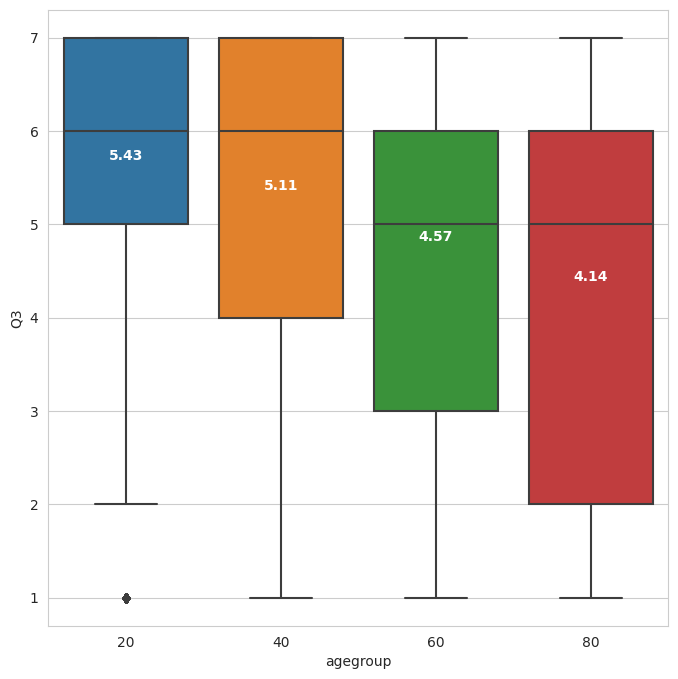

In [ ]:
sns.set_style('whitegrid')
boxplot = sns.boxplot(x='agegroup', y='Q3', data=allnumeric)
mean = allnumeric.groupby(['agegroup'])['Q3'].mean().round(2)
vertical_offset = allnumeric['Q3'].mean() * 0.05
for i, group in enumerate(mean.index):
    boxplot.text(i, mean[group] + vertical_offset, mean[group], ha='center', size=10, color='w', weight='semibold')


A medida que envejecemos, el nivel de estrés con el que te percibes comienza a disminuir

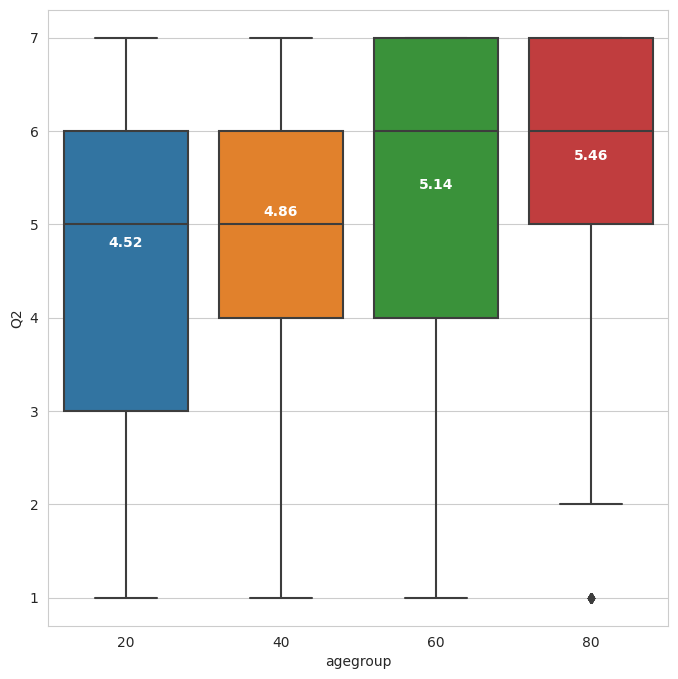

In [ ]:
sns.set_style('whitegrid')
boxplot = sns.boxplot(x='agegroup', y='Q2', data=allnumeric)
mean = allnumeric.groupby(['agegroup'])['Q2'].mean().round(2)
vertical_offset = allnumeric['Q2'].mean() * 0.05
for i, group in enumerate(mean.index):
    boxplot.text(i, mean[group] + vertical_offset, mean[group], ha='center', size=10, color='w', weight='semibold')


A medida que envejeces, el nivel de disciplina con el que se percibe a sí mísmo comienza a aumentar.

In [ ]:
#ANALISIS BIVARIADO-PRIFILER  - me da todos los datos del dataframe
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
from pandas_profiling import ProfileReport
profile = ProfileReport(all, title='My psy proj', html={'style':{'full_width':True}})
profile.to_notebook_iframe()

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     | 22.6 MB 19.7 MB/s 0:00:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.8/33.8 MB 17.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 108.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 10.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.8/679.8 kB 59.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.5/78.5 kB 12.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 34.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 110.5 MB/s eta 0:00:00
  Created wheel for ydata-profiling: filename=ydata_profiling-0.0.dev0-py2.py3-none-any.whl size=345992 sha256=5eb1db166b60c6e5dcaf54f651ff4bac414817c1f61c443ac49cb28acbf0adf5
  Stored in directory: /tmp/pip-ephem-wheel-

<ipython-input-68-a5550ead8201>:3: DeprecationWarning:

`import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.



Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#ANALISIS MULTIVARIADO
#veremos como se maneja
#pairplot
#facegrid
#sns.pairplot
#sns.FaceGrid

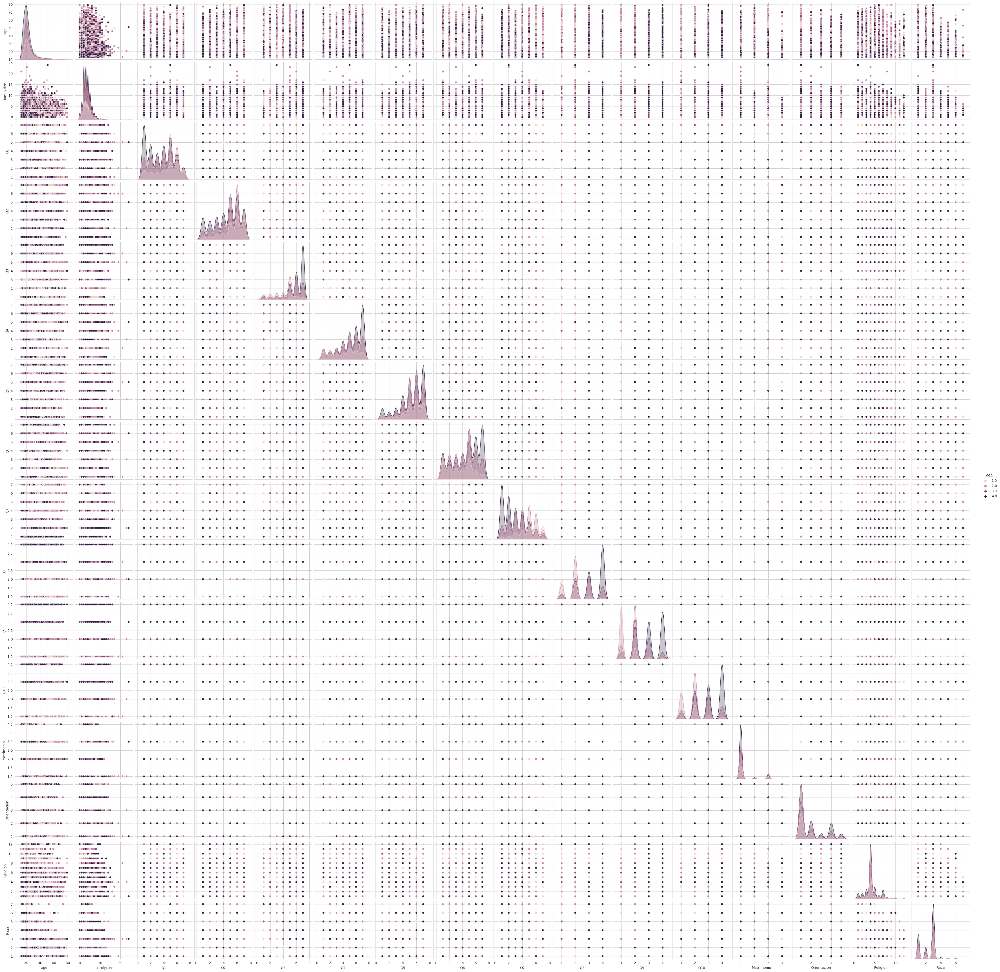

In [ ]:
sns.pairplot(allnumeric, hue='Q11')  #que me coloree desde la pregunta 11 en el eje y vamos a ver todas las preguntas, del costado derecho una etiqueta con los resultados del Q11

Las personas que no tienen capacidad de experimentar emociones positívas, sienten mayor ansiedad y mayor depresión


UTULIZAR 3 O MAS VARIABLES 

Status =

a) Q1 - Q3 - Q4 - Q6 = +8%

b) Q2 - Q5 - Q7 = -8%

c) Q8 - Q9 - Q10 - Q11 = +11%

In [ ]:
#agrego la variable a, b, c y operador 
allnumeric['a'] = (allnumeric['Q1']*0.08) + (allnumeric['Q3']*0.08) + (allnumeric['Q4']*0.08) + (allnumeric['Q6']*0.08)
allnumeric['b'] = (allnumeric['Q2']*0.08) + (allnumeric['Q5']*0.08) + (allnumeric['Q7']*0.08)
allnumeric['c'] = (allnumeric['Q8']*0.11) + (allnumeric['Q9']*0.11) + (allnumeric['Q10']*0.11) + (allnumeric['Q11']*0.11)
allnumeric['Operador'] = allnumeric['a'] + allnumeric['c'] - allnumeric['b']
#agrego status
allnumeric.loc[allnumeric['Operador'] <= 1.50, 'Status'] = 1
allnumeric.loc[allnumeric['Operador'] > 1.50, 'Status'] = 0 

In [ ]:
allnumeric = allnumeric.drop(['a','b','c','Operador'], axis = 1)
allnumeric

,age,familysize,Q1,Q2,Q3,Q4,Q5,Q6,Q7,Q8,Q9,Q10,Q11,Matrimonio,Orientacion,Religion,Raza,agegroup,Status
0,16,2.0,1.0,7.0,7.0,7.0,7.0,5.0,1.0,4.0,2.0,4.0,4.0,1,1,1,1,20,0.0
1,16,5.0,6.0,4.0,7.0,4.0,7.0,7.0,1.0,4.0,2.0,4.0,4.0,1,2,2,1,20,0.0
2,17,1.0,2.0,2.0,2.0,6.0,5.0,5.0,3.0,3.0,4.0,3.0,4.0,1,3,3,1,20,0.0
3,13,3.0,1.0,7.0,4.0,4.0,6.0,1.0,6.0,2.0,2.0,2.0,1.0,1,2,3,2,20,1.0
4,19,3.0,2.0,3.0,6.0,5.0,5.0,6.0,3.0,2.0,3.0,4.0,4.0,1,1,4,1,20,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39770,19,1.0,1.0,5.0,7.0,6.0,6.0,4.0,3.0,4.0,4.0,3.0,4.0,1,1,4,1,20,0.0
39771,27,4.0,6.0,6.0,7.0,4.0,6.0,5.0,5.0,2.0,1.0,2.0,2.0,1,1,3,3,40,1.0
39772,16,2.0,6.0,4.0,5.0,3.0,5.0,2.0,5.0,3.0,2.0,2.0,4.0,1,1,7,5,20,1.0
39773,16,4.0,2.0,3.0,5.0,5.0,5.0,3.0,3.0,2.0,3.0,3.0,4.0,1,5,5,3,20,0.0


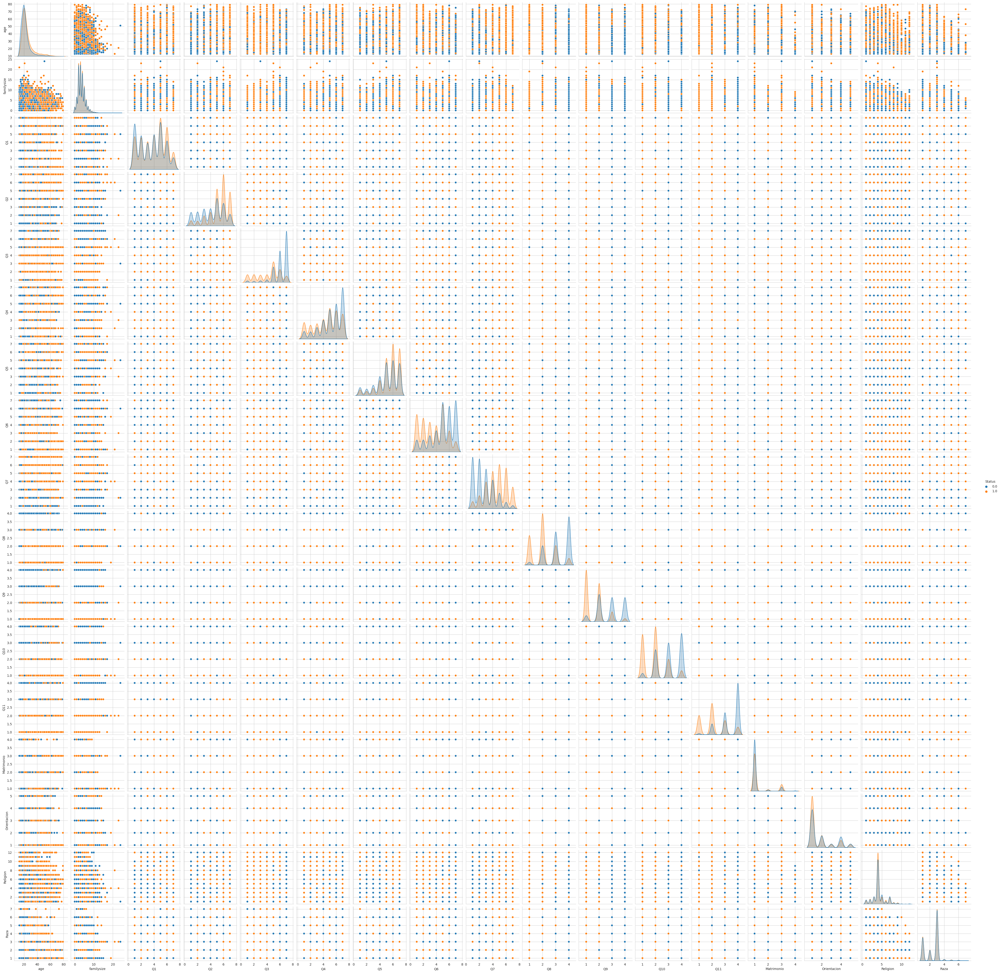

In [ ]:
sns.pairplot(allnumeric, hue = 'Status')

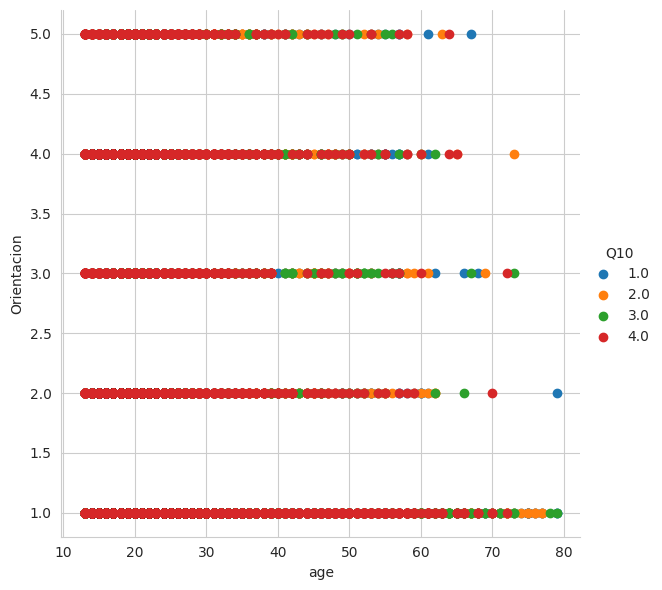

In [ ]:
sns.FacetGrid(allnumeric, hue='Q10', height = 6).map(plt.scatter, 'age', 'Orientacion').add_legend()
plt.show()

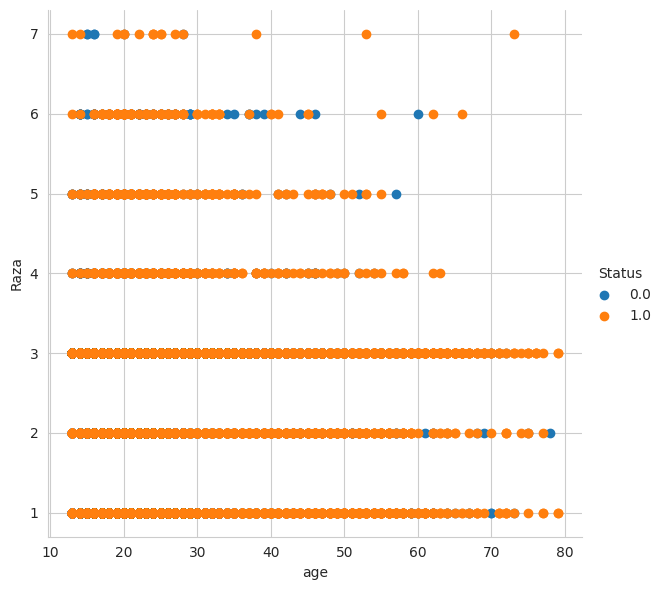

In [ ]:
sns.FacetGrid(allnumeric, hue='Status', height = 6).map(plt.scatter, 'age', 'Raza').add_legend()
plt.show()

In [ ]:
#MACHINE LEARNING
#cargo las librerías
from sklearn import linear_model
from sklearn.metrics import r2_score

In [ ]:
#Una vez que cargo las librerías, hago la funcion
regr = linear_model.LinearRegression() #pedímos que haga la regresión lineal
regresion = allnumeric[['Matrimonio', 'Orientacion', 'Q3', 'Q8', 'Q9', 'Q10', 'Q11']] #con cuales vamos a hacer el procedimiento
regresion

,Matrimonio,Orientacion,Q3,Q8,Q9,Q10,Q11
0,1,1,7.0,4.0,2.0,4.0,4.0
1,1,2,7.0,4.0,2.0,4.0,4.0
2,1,3,2.0,3.0,4.0,3.0,4.0
3,1,2,4.0,2.0,2.0,2.0,1.0
4,1,1,6.0,2.0,3.0,4.0,4.0
...,...,...,...,...,...,...,...
39770,1,1,7.0,4.0,4.0,3.0,4.0
39771,1,1,7.0,2.0,1.0,2.0,2.0
39772,1,1,5.0,3.0,2.0,2.0,4.0
39773,1,5,5.0,2.0,3.0,3.0,4.0


In [ ]:
#Vamos a hacer una mascara (msk). Le vamos a pedir que de forma aleatoria seleccione nuestros valores de entrenamiento y de testeo 
#Ya que el sistema necesita tener datos para identificar los patrones. 
#Le pedimos que de todos los datos, seleccione el 80% de forma aleatoria para que se entrene y el 20% para que pruebe si su procedimiento es el adecuado
msk = np.random.rand(len(regresion)) < 0.80 
train = regresion[msk] 
#20% restante es para testear si funciono su forma de entrenarse //no siempre van a lograr hacer todas las predicciones pero buscamos que sea un 70/80/80%
test = regresion[~msk]


In [ ]:
#decir cual es el objetivo - se va a realizar un procedimiento que se llama caja negra donde va a predecir cual va a ser el resultado en este caso de Q11
x = np.asanyarray(train[['Matrimonio', 'Orientacion', 'Q3', 'Q8', 'Q9', 'Q10']])  #los datos en tener en cuenta
y = np.asanyarray(train[['Q11']]) #el objetivo


In [ ]:
#le pedimos que se entrene, con todas las variables
regr.fit(x, y)

LinearRegression()

In [ ]:
#revisar cual fue el resultado del coeficiente 
#el modelo de regresión lineal va a funcionar con mayor acertividad si la tendencia de nuestros valores es directamente proporcional 
print('Coef', regr.coef_)

Coef [[-0.03853314  0.0148696   0.06483039  0.2237832   0.40500688  0.18661806]]


In [ ]:
#Q9 es la variable que más esta incidiendo con Q11 

In [ ]:
#Para llegar al valor final
y_hat = regr.predict(test[['Matrimonio', 'Orientacion', 'Q3', 'Q8', 'Q9', 'Q10']]) #nos va a permitir hacer una prediccion
#revisamos x y y pero con el testeo
x = np.asanyarray(test[['Matrimonio', 'Orientacion', 'Q3', 'Q8', 'Q9', 'Q10']])  
y = np.asanyarray(test[['Q11']]) 

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but LinearRegression was fitted without feature names



In [ ]:
print('¿me sirve el modelo? %.2f' % regr.score(x,y))  #le pedimos que nos muestre el resultado final basandonos en los nuevos valores de x y y

¿me sirve el modelo? 0.51


In [ ]:
#no me sirve // solo el 50% me va a dar adecuado - en ML se llama que el modelo es tan bueno como lanzar una moneda al aire y decidir con base en eso

In [ ]:
#utilizar otro modelo, este no nos sirve

In [ ]:
p = sns.load_dataset ('iris')
p

,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa
...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,virginica
146,6.3,2.5,5.0,1.9,virginica
147,6.5,3.0,5.2,2.0,virginica
148,6.2,3.4,5.4,2.3,virginica


In [ ]:
#otra forma de obtener el 80%
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split #hace lo mismo que la mascara pero en una sola linea

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(p.sepal_length, p.petal_width, test_size = 0.20, random_state = 42)


In [ ]:
z = X_train.values.reshape(-1,1) #hacer un vector

In [ ]:
lr = LinearRegression()
lr.fit(z, y_train.values) #le vamos a pedir q se entrene con  X_train

LinearRegression()

In [ ]:
#mismos valores de entrenamiento solo que para testeo
zz = X_test.values.reshape(-1,1) #hacer un vector

In [ ]:
#que prediga nuestros valores
pred = lr.predict(zz)

In [ ]:
#revisar si el valor final es el adecuado
lr.score(zz, y_test.values)

0.7575009893273534

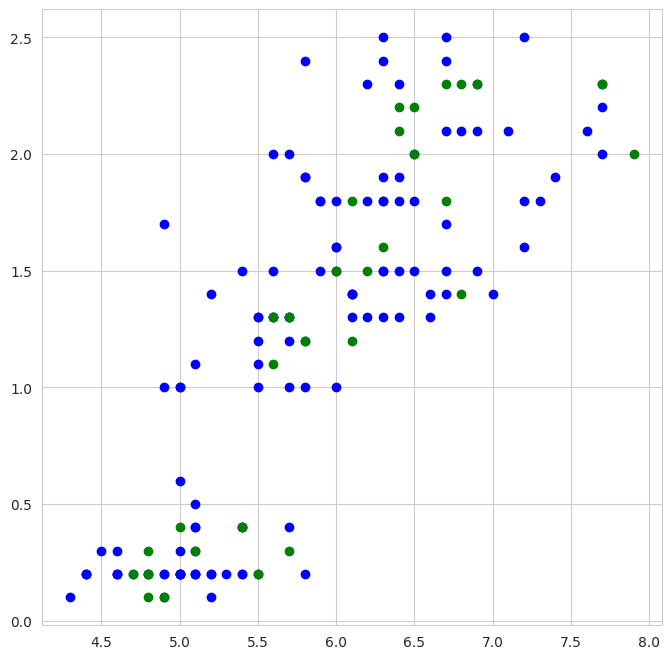

In [ ]:
#con cuantos valores esta entrenando y con cuantos esta testeando
plt.scatter(X_train, y_train, color= 'b')   #entrenamiento
plt.scatter(X_test, y_test, color= 'g')  #testeo
plt.show()   #va a utilizar todos los azules para intentar predecir los verdes
#estamos hablando de una regresion lineal

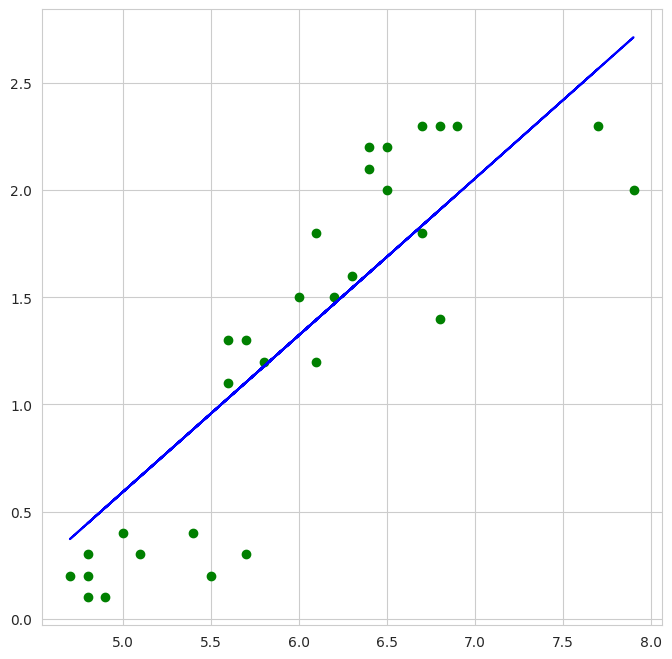

In [ ]:
plt.plot(X_test, pred, color = 'b')
plt.scatter(X_test, y_test, color = 'g')
plt.show() #vemos la línea que mejor intenta ajustarse a todos los puntos de la gráfica 

In [ ]:
#le pído que me prediga que pasa si llega  a la gráfica un valor de 9
lr.predict(np.array([[9]]))[0]

3.5187101893575505

In [ ]:
from sklearn.preprocessing import MinMaxScaler  #le voy a pedir a sklearn que haga el escalamiento de los datos por medio de MinMaxScaler

In [ ]:
es = MinMaxScaler() 
es.fit(allnumeric) #vamos a pedírle que es se entrene con todas nuestras variables
esc = es.transform(allnumeric) #una vez que se entrene, que haga la transformación
esc = pd.DataFrame(esc) #todo lo que acaba de hacer le vamos a pedir que lo inserte en un nuevo dataframe partiendo de esc


In [ ]:
from sklearn.decomposition import PCA #traemos PCA 
pca = PCA(n_components = 2) #que lo traiga en solo 2 componentes
e = pca.fit_transform(esc) #entrene ese PCA

In [ ]:
from sklearn.cluster import KMeans #KMeans es un metodo de agrupamiento, hace que la partición del conjunto en observaciones va a mirar cual observación pertenece a un grupo cuyo valor medio es el mas cercano y esto pertenece a nuestro método de cluster
wcss= [] #lísta vacía
for i in range(1, 12): #una lísta donde lo agrupapos en hasta 12 componentes
  kmeans = KMeans(n_clusters = i , init = 'k-means++', random_state = 42) #que se vaya modificando en el siglo/ es una practica aconsejable agregar un random state
  kmeans.fit(e) #que se entrene pero con los valores del PSA que ya logro identificar
  wcss.append(kmeans.inertia_)  #que lo inserte en la lísta vacía

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

Exception ignored on calling ctypes callback function: <function ThreadpoolController._find_libraries_with_dl_iterate_phdr.<locals>.match_library_callback at 0x7fbdd222c4c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.9/dist-packages/threadpoolctl.py", line 584, in match_library_callback
    self._make_controller_from_path(filepath)
  File "/usr/local/lib/python3.9/dist-packages/threadpoolctl.py", line 725, in _make_controller_from_path
    lib_controller = lib_controller_class(
  File "/usr/local/lib/python3.9/dist-packages/threadpoolctl.py", line 842, in __init__
    super().__init__(**kwargs)
  File "/usr/local/lib/python3.9/dist-packages/threadpoolctl.py", line 810, in __init__
    self._dynlib = ctypes.CDLL(filepath, mode=_RTLD_NOLOAD)
  File "/u

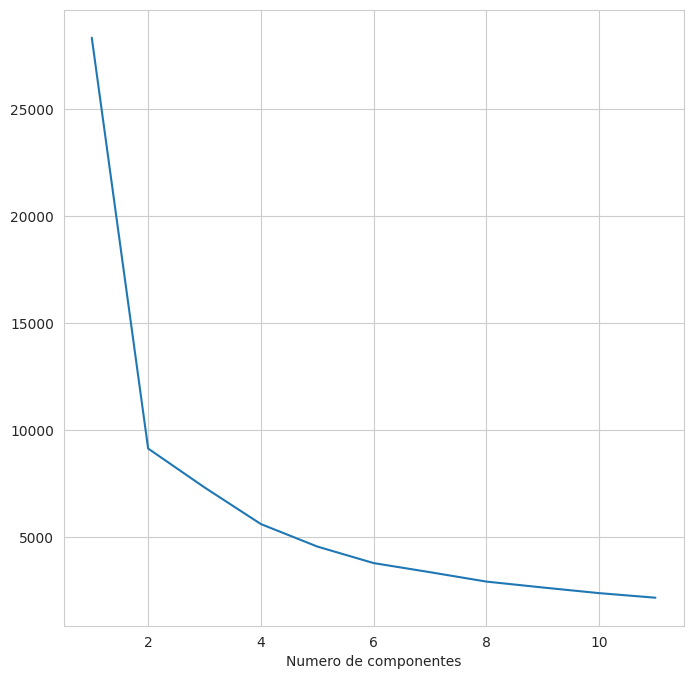

In [ ]:
plt.plot(range(1,12), wcss) #rango del 1 al 12
plt.xlabel('Numero de componentes') 
plt.show() 

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change fro

<bound method Visualizer.show of KElbowVisualizer(ax=<Axes: >, estimator=KMeans(n_clusters=11, random_state=42),
                 k=(1, 12))>

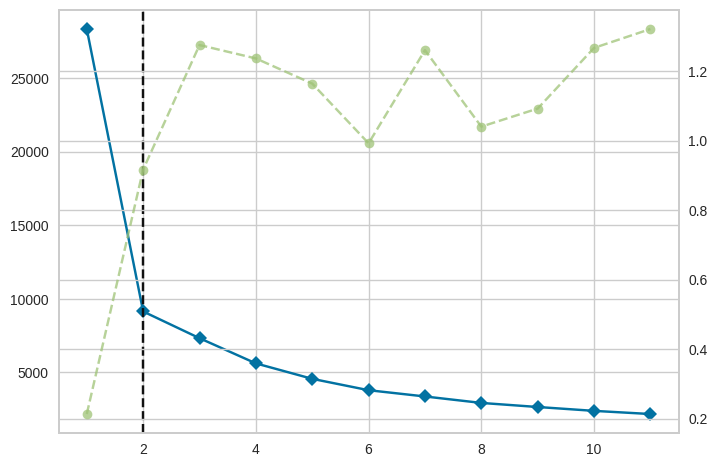

In [ ]:
#implementar más métodos para poder seleccionar el número adecuado
#otras dos opciones para determinar si lo hace de forma adecuado

#este gráfico nos dirá desde donde puede funcionar esa selección del codo. Yellowbrick
from yellowbrick.cluster import KElbowVisualizer
visual = KElbowVisualizer(kmeans, k=(1, 12)) #que lo grafique del 1 al 12
visual.fit(e) #que nos entrene todos los elementos que tenemos entrenados por nuestro PSA
visual.show #que nos muestre todo lo que proceso

Nos dice que de 0 a 2 no nos va a servir, podriamos tomar de 2 a 8 por ejemplo 

In [ ]:
pca = PCA(n_components = 8) 
e = pca.fit_transform(esc)

In [ ]:
#prefiero utilizar directamente el procedimiento matemático que nos va a explicar cuanto es la descripción de la varianza explicada por los componentes 
print("Varianza explicada por el primer componente", np.cumsum (pca.explained_variance_ratio_*100)[0] ) #varianza que explica el primer componente

#ver lo que ocurre con más componentes 
print("Varianza explicada por los primeros dos componente", np.cumsum (pca.explained_variance_ratio_*100)[1] )
print("Varianza explicada por los primeros tres componente", np.cumsum(pca.explained_variance_ratio_*100)[2])
print("Varianza explicada por los primeros cuatro componente", np.cumsum (pca.explained_variance_ratio_*100)[3] )
print("Varianza explicada por los primeros cinco componente", np.cumsum (pca.explained_variance_ratio_*100)[4] ) 
print("Varianza explicada por los primeros seis componente", np.cumsum (pca.explained_variance_ratio_*100)[5] ) 
print("Varianza explicada por los primeros siete componente", np.cumsum (pca.explained_variance_ratio_*100)[6] ) 
print("Varianza explicada por los primeros ocho componente", np.cumsum (pca.explained_variance_ratio_*100)[7] ) 

Varianza explicada por el primer componente 35.67599617629724
Varianza explicada por los primeros dos componente 43.53356886667202
Varianza explicada por los primeros tres componente 51.35582326751868
Varianza explicada por los primeros cuatro componente 57.96185455710446
Varianza explicada por los primeros cinco componente 64.0335149820585
Varianza explicada por los primeros seis componente 68.76721536245208
Varianza explicada por los primeros siete componente 72.98193776005583
Varianza explicada por los primeros ocho componente 77.115053610233


In [ ]:
#ver los resultados de forma gráfica-decidimos que sean 8 clusters
kmenas = KMeans(n_clusters = 8, init = 'k-menas++', random_state=42)
label = kmeans.fit_predict(e)
u_labels = np.unique(label) #que nos vaya mostrando cada uno de los clusters

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



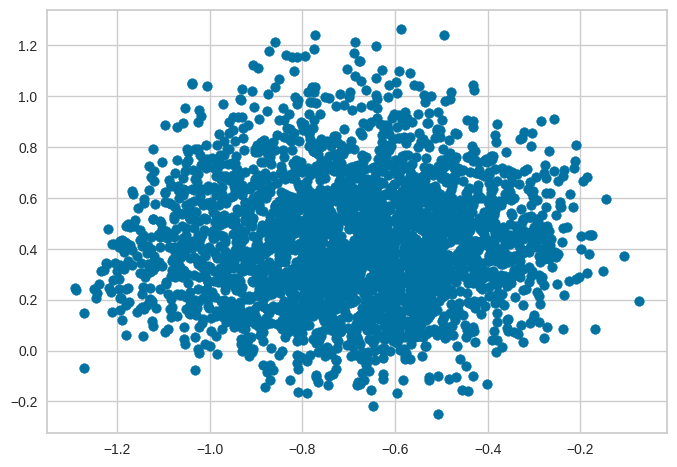

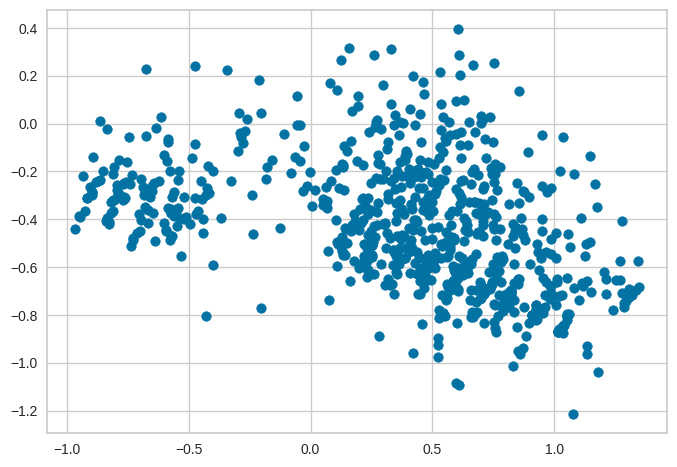

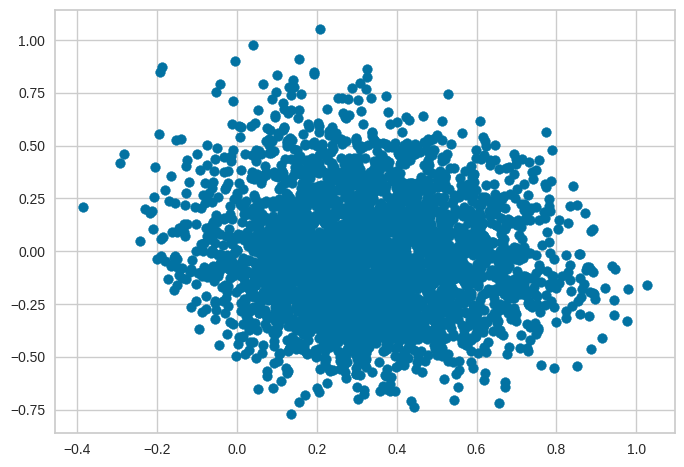

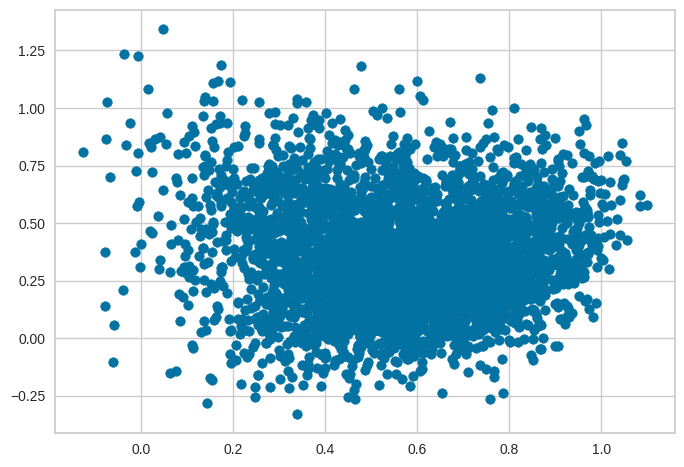

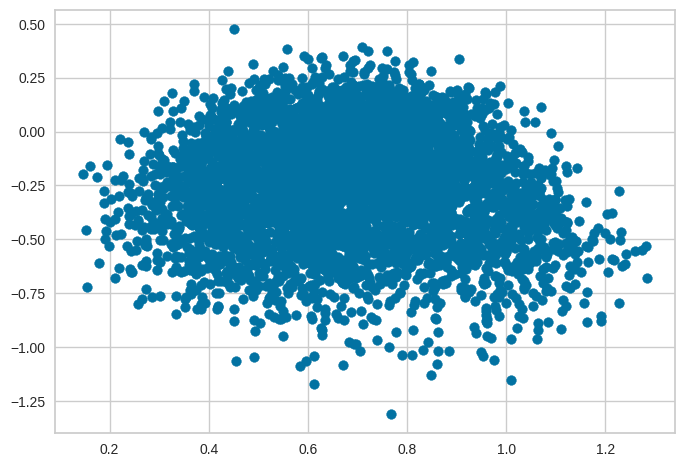

...

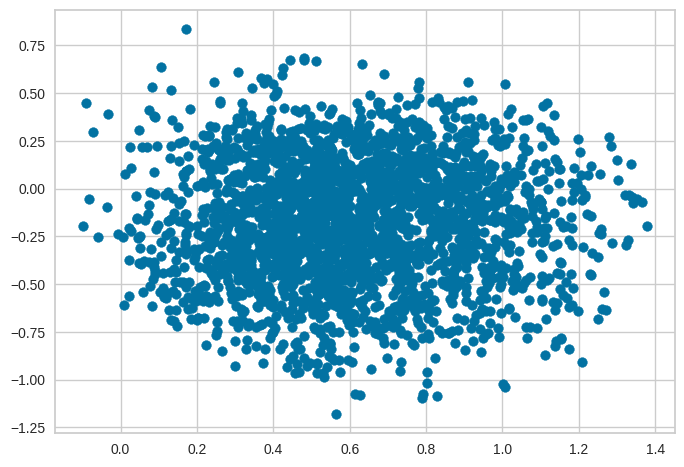

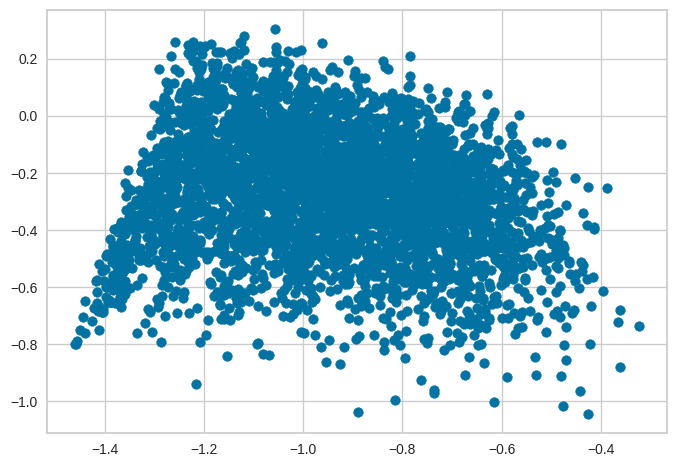

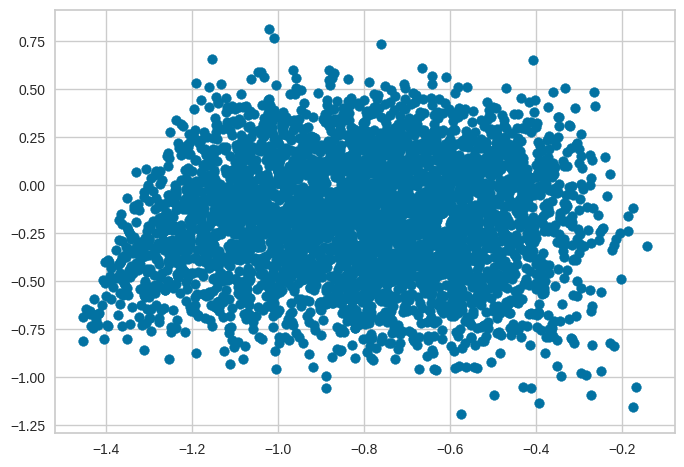

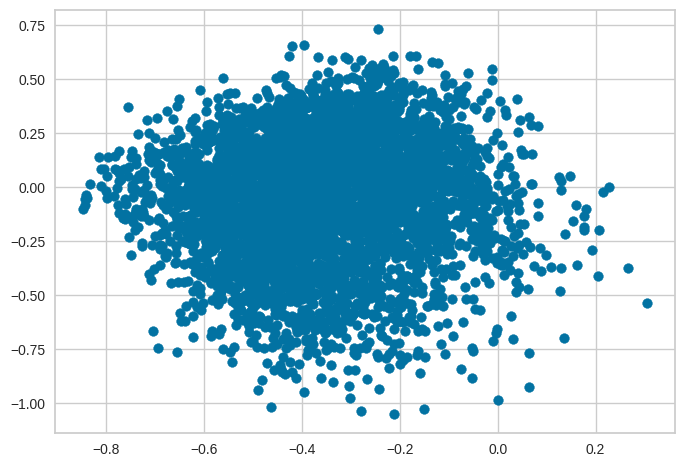

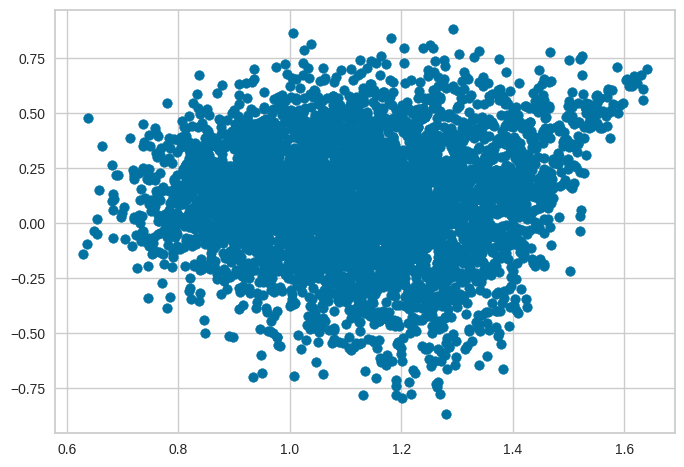

In [ ]:
for i in u_labels:
  plt.scatter(e[label==i, 0], e[label == i , 1], label =i) #pedímos que nos haga un gráfico
  plt.show() #quiere decir que con 8 componentes podemos representar las 19 variables

In [ ]:
#APIS
#importar la librería 
import requests

In [ ]:
#ingresar a NASA API, es gratuita
url = 'https://api.nasa.gov/planetary/apod'
query = {'api_key': 'aUUvxdF6ctqMOiYICzw4WGpm9vVqKhQrgZKHc2tc'}

response = requests.get(url, params = query)
#cada API tiene sus formas de envío de datos - ver en cada documentación 
if response.status_code==200:  #es una alerta para cuando se demora mucho o falla en nuestra solicitud
  data = response.json ()#nos va a guardar los datos en un punto json que es un formato de texto para intercambiar datos
  print("Titulo", data['title'])
  print("Descripcion", data['explanation'])
  print("Imagen", data['url']) #nos envíe el link de la imagen más importante de la nasa para el dia de hoy
  print("Dia", data['date']) 
else:
    print("Error en la API")

Titulo Portrait of NGC 3628
Descripcion Sharp telescopic views of NGC 3628 show a puffy galactic disk divided by dark dust lanes. Of course, this portrait of the magnificent, edge-on spiral galaxy puts some astronomers in mind of its popular moniker, the Hamburger Galaxy. It also reveals a small galaxy nearby (below), likely a satellite of NGC 3628, and a very faint but extensive tidal tail. The drawn out tail stretches for about 300,000 light-years, even beyond the left edge of the frame. NGC 3628 shares its neighborhood in the local universe with two other large spirals M65 and M66 in a grouping otherwise known as the Leo Triplet. Gravitational interactions with its cosmic neighbors are likely responsible for creating the tidal tail, as well as the extended flare and warp of this spiral's disk. The tantalizing island universe itself is about 100,000 light-years across and 35 million light-years away in the northern springtime constellation Leo.
Imagen https://apod.nasa.gov/apod/image

In [ ]:
#imgresar a API WIKIPEDIA 
#requiere una instalación
! pip install wikipedia-api

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import wikipediaapi

#vamos a traer un diccionario con algunos artículos de wikipedia
wiki = wikipediaapi.Wikipedia(
    language = 'es',
    extract_format = wikipediaapi.ExtractFormat.WIKI #en el formato wiki
)

page = wiki.page("Salud Mental")  #le voy a solicitar que me traiga las primeras palabras de esa página
page2 = wiki.page("Filosofía de la mente")

print(" Pag - Resumen %s" % page.summary[0:250])


 Pag - Resumen La salud mental es, en términos generales, el estado de equilibrio entre una persona y su entorno socio-cultural que garantiza su participación laboral, intelectual, las relaciones para alcanzar un bienestar y una buena calidad de vida. Comúnmente, s


In [ ]:
#hacer un dataframe
#traemos una lísta nombre y otra resumen
nombre = []
resumen = []
nombre.append(page.title[0:20])  #título de nuestra página
nombre.append(page2.title[0:40])  #que haga lo mismo con page2
resumen.append(page.summary[0:240])
resumen.append(page2.summary[0:200])

In [ ]:
wiki = pd.DataFrame(nombre, resumen)
wiki = wiki.reset_index() #que nos resetee el índice
wiki = wiki.rename({'index': 'Resumen', 0 : 'Nombre'}, axis=1)
wiki

,Resumen,Nombre
0,"La salud mental es, en términos generales, el ...",Salud mental
1,La filosofía de la mente es la rama de la filo...,Filosofía de la mente
